In [1]:
import random
import wolsim
import numpy as np
import matplotlib.pyplot as plt

random.seed(123)
np.random.seed(123)

We run the following code, which will display Matplotlib animations within this notebook.

In [2]:
plt.rcParams['animation.html'] = 'jshtml'
plt.ioff()

## Model 1 : Signalling compound

First, we simulate the hypothesis that the wolbachia produces a signalling compound which inhibits growth of the virus.

The simulation takes place on a rectangular grid of cells. Each cell is characterized by the presence or absence of the Wolbachia, a count of virus, and a concentration of signalling compound.

### Virus (agent-based)

The agent-based model of virus dynamics updates the virus count in each cell acccording to two mechanisms: diffusion and reproduction.

#### Diffusion

The virus has a parameter, `diffuse_rate`, specifying its tendency to move to neighboring cells. For each virus in a cell, a number of moves is sampled according to $\text{Poisson}(\text{diffuse\_rate})$. Each move consists of a random direction (up, down, left, or right) and moves the virus to the neighboring cell in that direction. If a virus ever moves out of the simulation grid, it is removed from further simulation and cannot return.

#### Reproduction

The virus has two parameters controlling its growth within a cell, namely `growth_rate` ($r$) and `carrying_capacity` ($K$). The rate of change of the virus count is computed according to $\alpha = r *  v * (1-v/K)$, where $v$ is the current virus count. If this quantity is positive, a random number sampled according to $\text{Poisson}(\alpha)$ is added to $v$; if $\alpha$ is negative, a random number sampled from $\text{Poisson}(-\alpha)$ is subtracted from $v$ (if $v$ would go negative after such a step, it is simply set to zero).


### Signalling compound

The concentration $S$ of the signalling compound is assumed to obey the following PDE:

$$\frac{dS}{dt} = D\; \nabla^2 S(x,y) + w\;\eta(x, y) - \gamma S(x,y)  - g \;v(x,y)\; S(x,y) $$

where we have the following parameters:

| Term                                                                                  | Interpretation                     |
|---------------------------------------------------------------------------------------|------------------------------------|
| $D$                                                                                   | Diffusion rate                     |
| $w\; \eta(x, y) = \begin{cases}w & \text{Wol. present} \\ 0 & \text{else}\end{cases}$ | Secretion of compound by wolbachia |
| $\gamma$                                                                              | Degradation of compound            |
| $g$                                                                                   | Consumption of compound by virus   |

We assume that the substance diffuses at a faster timescale than the viral proliferation. Thus, at each iteration we compute $S$ as the steady state solution of the PDE (i.e., when $dS/dt = 0$).

Subsequently, the growth rate of the virus in the agent based model is modulated according to:

$$r_\text{effective} = r \; \exp(-\beta S)$$

for some parameter $\beta$ controlling the magnitude of the decrease of viral growth with the compound.


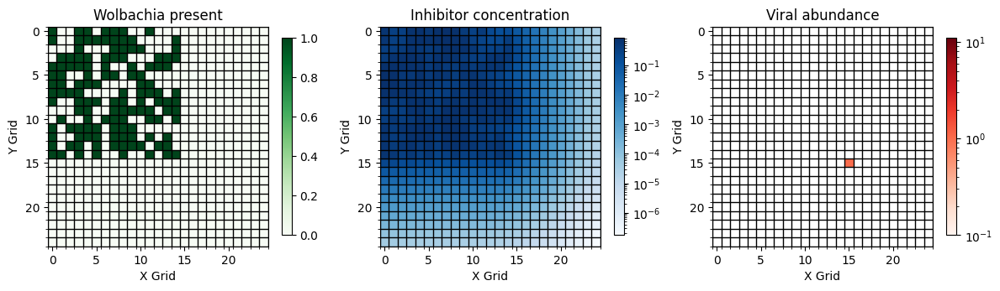

In [3]:
t = 200

model = wolsim.AgentBasedModel(25, 25, model='signalling')
model.set_virus_parameters(0.1, 1.0, 5.0, 0)
model.initialize_virus(0)
model.initialize_wolbachia(0.55)
    
for _ in range(t):
    model.run_time_step()

plotter = wolsim.SimulationAnimation(model)
animation = plotter.plot()
animation

In [4]:
animation.save('Figure1.gif', writer='imagemagick', fps=30)

## Model 2 : Epigenetic

Next, we consider the hypothesis that virus which reproduce in a cell which has wolbachia have a genetic change which decreases their growth rate.

As before, the simulation takes place on a rectangular grid of cells. Each cell is characterized by the presence or absence of the Wolbachia, a count of unmodified virus, and a count of modified virus.

Both types of virus obey the same agent based model as described above, with different growth rate parameters. The modified type has a reduced growth rate and is formed whenever a modified type reproduces anywhere, or whenever an unmodified type reproduces in a cell where wolbachia is present.

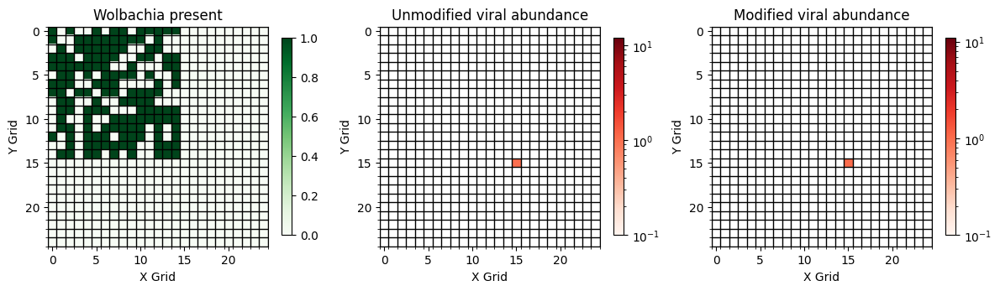

In [5]:
t = 200

model = wolsim.AgentBasedModel(25, 25, model='genetic')
model.set_virus_parameters(0.1, 1.0, 5.0, 0)
model.set_virus_parameters(0.1, 0.05, 5.0, 1)
model.initialize_virus(0)
model.initialize_wolbachia(0.55)
    
for _ in range(t):
    model.run_time_step()

plotter = wolsim.SimulationAnimation(model)
animation = plotter.plot_twovirus()
animation

In [6]:
animation.save('Figure2.gif', writer='imagemagick', fps=30)